# 터닝포인트 (K리그 경기 변곡점 분석) - 실제 데이터

이 노트북은 실제 K리그 데이터를 사용하여 경기 변곡점을 분석합니다.

In [1]:
# 환경 설정 및 라이브러리 import
import sys
from pathlib import Path
import os
from IPython.display import Image, display

# 프로젝트 루트를 경로에 추가
project_root = Path.cwd()
sys.path.insert(0, str(project_root))

# 프로젝트 모듈 import
from src.data.loader import load_match_by_id, list_available_matches
from src.analysis.turning_point import detect_turning_points
from src.explanation.generator import ExplanationGenerator
from src.visualization.plotter import (
    plot_momentum_curve,
    plot_player_heatmap,
    plot_player_movements
)
from src.analysis.player_analysis import (
    extract_player_activities,
    get_key_players,
    get_player_event_summary
)

# 프로젝트 루트 경로
PROJECT_ROOT = Path.cwd()
RAW_DATA_PATH = PROJECT_ROOT / "raw_data.csv"
MATCH_INFO_PATH = PROJECT_ROOT / "match_info.csv"

print("라이브러리 로드 완료!")

라이브러리 로드 완료!


## 1. 사용 가능한 경기 목록 확인

In [3]:
# 사용 가능한 경기 목록 출력 (페이지네이션)
matches = list_available_matches(str(MATCH_INFO_PATH))
total_matches = len(matches)
page_size = 10
current_page = 0
total_pages = (total_matches + page_size - 1) // page_size

print(f"총 {total_matches}개의 경기가 있습니다. (페이지당 {page_size}개)")
print("="*60)

# 페이지네이션 루프
while True:
    start_idx = current_page * page_size
    end_idx = min(start_idx + page_size, total_matches)
    page_matches = matches.iloc[start_idx:end_idx]
    
    print(f"\n[페이지 {current_page + 1}/{total_pages}]")
    print(page_matches.to_string(index=False))
    
    # 네비게이션 옵션
    print("\n" + "="*60)
    if current_page > 0 and current_page < total_pages - 1:
        nav_prompt = "다음 페이지(n), 이전 페이지(p), 경기 ID 입력 또는 엔터(첫 번째 경기): "
    elif current_page > 0:
        nav_prompt = "이전 페이지(p), 경기 ID 입력 또는 엔터(첫 번째 경기): "
    elif current_page < total_pages - 1:
        nav_prompt = "다음 페이지(n), 경기 ID 입력 또는 엔터(첫 번째 경기): "
    else:
        nav_prompt = "경기 ID 입력 또는 엔터(첫 번째 경기): "
    
    user_input = input(nav_prompt).strip().lower()
    
    # 다음 페이지
    if user_input == 'n' and current_page < total_pages - 1:
        current_page += 1
        continue
    # 이전 페이지
    elif user_input == 'p' and current_page > 0:
        current_page -= 1
        continue
    # 경기 ID 입력 또는 엔터
    else:
        if user_input:
            try:
                game_id = int(user_input)
                # 입력한 경기 ID가 목록에 있는지 확인
                if game_id not in matches['game_id'].values:
                    print(f"⚠️  경고: 경기 ID {game_id}가 목록에 없습니다. 첫 번째 경기를 사용합니다.")
                    game_id = matches.iloc[0]['game_id']
                else:
                    selected_match = matches[matches['game_id'] == game_id].iloc[0]
                    print(f"\n✅ 선택된 경기: {selected_match['home_team_name_ko']} vs {selected_match['away_team_name_ko']}")
                    print(f"   경기 날짜: {selected_match['game_date']}")
                    print(f"   스코어: {selected_match['home_score']} - {selected_match['away_score']}")
                    break
            except ValueError:
                print(f"⚠️  경고: 올바른 숫자를 입력해주세요. 첫 번째 경기를 사용합니다.")
                game_id = matches.iloc[0]['game_id']
                break
        else:
            # 엔터만 누른 경우 첫 번째 경기 자동 선택
            game_id = matches.iloc[0]['game_id']
            selected_match = matches.iloc[0]
            print(f"\n✅ 첫 번째 경기 자동 선택: {selected_match['home_team_name_ko']} vs {selected_match['away_team_name_ko']}")
            print(f"   경기 ID: {game_id}")
            break

print(f"\n분석할 경기 ID: {game_id}")

총 198개의 경기가 있습니다. (페이지당 10개)

[페이지 1/20]
 game_id           game_date home_team_name_ko away_team_name_ko  home_score  away_score
  126283 2024-03-01 05:00:00          울산 HD FC           포항 스틸러스           1           0
  126284 2024-03-01 07:30:00         전북 현대 모터스         대전 하나 시티즌           1           1
  126285 2024-03-02 05:00:00              광주FC              FC서울           2           0
  126286 2024-03-02 07:30:00          인천 유나이티드              수원FC           0           1
  126287 2024-03-02 07:30:00              강원FC           제주SK FC           1           1
  126288 2024-03-03 05:00:00              대구FC       김천 상무 프로축구단           0           1
  126289 2024-03-09 05:00:00              수원FC         전북 현대 모터스           1           1
  126290 2024-03-09 07:30:00           포항 스틸러스              대구FC           3           1
  126291 2024-03-09 07:30:00       김천 상무 프로축구단          울산 HD FC           2           3
  126292 2024-03-10 05:00:00           제주SK FC         대전 하나 시티즌     

다음 페이지(n), 경기 ID 입력 또는 엔터(첫 번째 경기):  



✅ 첫 번째 경기 자동 선택: 울산 HD FC vs 포항 스틸러스
   경기 ID: 126283

분석할 경기 ID: 126283


## 2. 경기 데이터 로드

In [4]:
# 경기 데이터 로드
print(f"경기 ID {game_id} 분석 중...")

try:
    match_data = load_match_by_id(
        str(RAW_DATA_PATH),
        str(MATCH_INFO_PATH),
        game_id
    )
    
    print(f"\n경기: {match_data.home_team} vs {match_data.away_team}")
    print(f"경기 날짜: {match_data.match_date}")
    print(f"최종 스코어: {match_data.final_score['home']} - {match_data.final_score['away']}")
    print(f"이벤트 수: {len(match_data.events)}")
except Exception as e:
    print(f"오류 발생: {e}")
    import traceback
    traceback.print_exc()

경기 ID 126283 분석 중...

경기: 울산 HD FC vs 포항 스틸러스
경기 날짜: 2024-03-01 05:00:00
최종 스코어: 1 - 0
이벤트 수: 2240


## 3. 변곡점 탐지

In [6]:
# 변곡점 탐지
print("변곡점 탐지 중...")
turning_points = detect_turning_points(match_data)
print(f"탐지된 변곡점: {len(turning_points)}개\n")

# 변곡점 정보 출력
for tp in turning_points:
    team_name = (
        match_data.home_team if tp.team_advantage == 'home'
        else match_data.away_team
    )
    print(f"[{tp.minute}분] {team_name}")
    print(f"  유형: {tp.change_type}")
    print(f"  지표: {', '.join(tp.indicators)}")
    print()

변곡점 탐지 중...
탐지된 변곡점: 13개

[10분] 울산 HD FC
  유형: defense_breakdown
  지표: attack_zone_change, defense_line_shift

[20분] 울산 HD FC
  유형: defense_breakdown
  지표: attack_zone_change, defense_line_shift

[25분] 울산 HD FC
  유형: attack_surge
  지표: xG_change, attack_zone_change, pass_pattern_change

[30분] 포항 스틸러스
  유형: attack_surge
  지표: xG_change, attack_zone_change, defense_line_shift, pass_pattern_change

[35분] 울산 HD FC
  유형: attack_surge
  지표: xG_change, attack_zone_change, defense_line_shift, pass_pattern_change

[40분] 울산 HD FC
  유형: momentum_shift
  지표: attack_zone_change, pass_pattern_change

[50분] 울산 HD FC
  유형: attack_surge
  지표: xG_change, attack_zone_change, defense_line_shift

[55분] 울산 HD FC
  유형: attack_surge
  지표: xG_change, attack_zone_change, defense_line_shift

[60분] 울산 HD FC
  유형: defense_breakdown
  지표: attack_zone_change, defense_line_shift

[65분] 포항 스틸러스
  유형: defense_breakdown
  지표: attack_zone_change, defense_line_shift

[70분] 포항 스틸러스
  유형: defense_breakdown
  지표: attack_zone

## 4. 설명 생성

In [7]:
# 설명 생성
explanation_gen = ExplanationGenerator()

for tp in turning_points:
    team_name = (
        match_data.home_team if tp.team_advantage == 'home'
        else match_data.away_team
    )
    tp.explanation = explanation_gen.generate_explanation(tp, team_name)
    print(f"[{tp.minute}분] {team_name}")
    print(f"  유형: {tp.change_type}")
    print(f"  지표: {', '.join(tp.indicators)}")
    print(f"  설명: {tp.explanation}\n")

# 전체 요약
summary = explanation_gen.generate_summary(
    turning_points,
    match_data.home_team,
    match_data.away_team
)
print(f"전체 요약:")
print(f"  {summary}")

[10분] 울산 HD FC
  유형: defense_breakdown
  지표: attack_zone_change, defense_line_shift
  설명: 10분 이후 울산 HD FC의 수비가 더욱 공격적으로 변했습니다. 수비 라인이 전진하며 상대를 압박하는 강도가 높아졌고, 이로 인해 공격 기회가 늘어났습니다.

[20분] 울산 HD FC
  유형: defense_breakdown
  지표: attack_zone_change, defense_line_shift
  설명: 20분을 기점으로 울산 HD FC의 수비가 후퇴하기 시작했습니다. 수비 라인이 낮아지며 수동적인 수비로 전환되었고, 상대의 공격을 막기 어려운 상황이 되었습니다.

[25분] 울산 HD FC
  유형: attack_surge
  지표: xG_change, attack_zone_change, pass_pattern_change
  설명: 울산 HD FC의 공격이 25분 이후 급격히 살아났습니다. 슈팅 시도가 0회에서 1회로 증가했고, 상대 진영에서의 활동도 활발해지며 경기 주도권을 잡았습니다.

[30분] 포항 스틸러스
  유형: attack_surge
  지표: xG_change, attack_zone_change, defense_line_shift, pass_pattern_change
  설명: 포항 스틸러스의 공격이 30분 이후 급격히 살아났습니다. 슈팅 시도가 0회에서 0회로 증가했고, 상대 진영에서의 활동도 활발해지며 경기 주도권을 잡았습니다.

[35분] 울산 HD FC
  유형: attack_surge
  지표: xG_change, attack_zone_change, defense_line_shift, pass_pattern_change
  설명: 35분을 기점으로 울산 HD FC의 공격이 폭발했습니다. 기대득점(xG)이 0.00에서 0.36로 상승하며 실제 골로 이어질 가능성이 높아진 상황이었습니다.

[40분] 울산 HD FC
  유형: momentum_shift
  지표

## 5. 모멘텀 곡선 시각화

그래프 생성 중...
그래프가 'momentum_curve_126283.png'로 저장되었습니다.



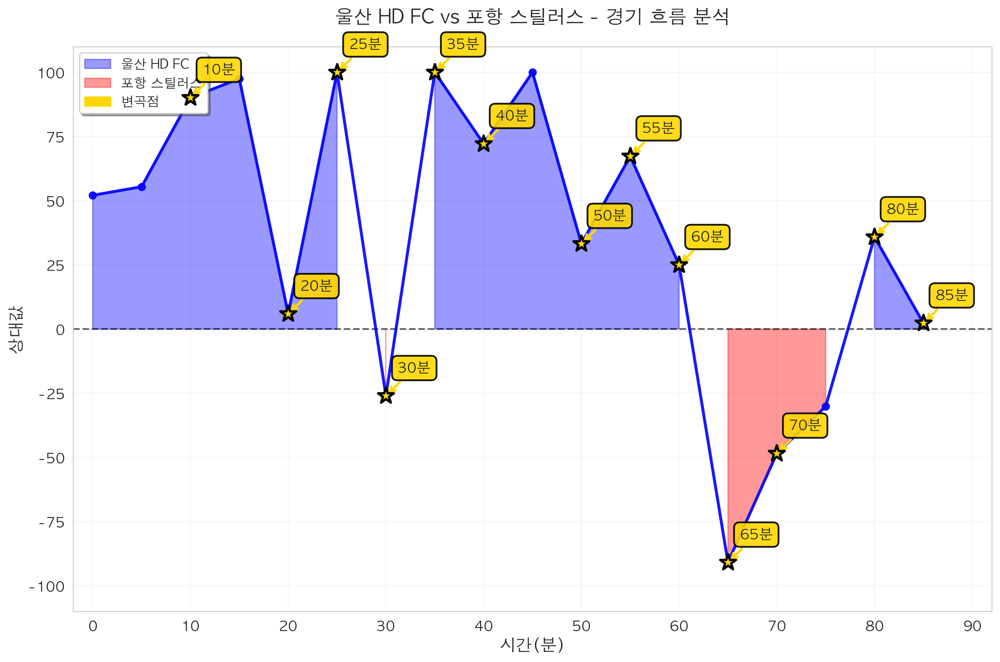

In [8]:
# 모멘텀 곡선 그래프 생성
print("그래프 생성 중...")
output_path = f"momentum_curve_{game_id}.png"
plot_momentum_curve(match_data, turning_points, output_path)
print(f"그래프가 '{output_path}'로 저장되었습니다.\n")

# 이미지를 노트북 셀에 인라인으로 표시
if os.path.exists(output_path):
    display(Image(output_path))

## 6. 변곡점별 선수 분석

변곡점별 선수 분석 중...

[10분] 변곡점 선수 분석...
  분석된 선수 수: 11
  주요 선수 (상위 5명):
    - 황석호: 영향도 60.0 (슈팅: 0, 패스: 33, xG: 0.00)
    - 설영우: 영향도 55.0 (슈팅: 0, 패스: 17, xG: 0.00)
    - 이규성: 영향도 51.0 (슈팅: 0, 패스: 18, xG: 0.00)
    - 김영권: 영향도 48.0 (슈팅: 0, 패스: 28, xG: 0.00)
    - 고승범: 영향도 48.0 (슈팅: 0, 패스: 19, xG: 0.00)
  히트맵 저장: heatmap_126283_10.png


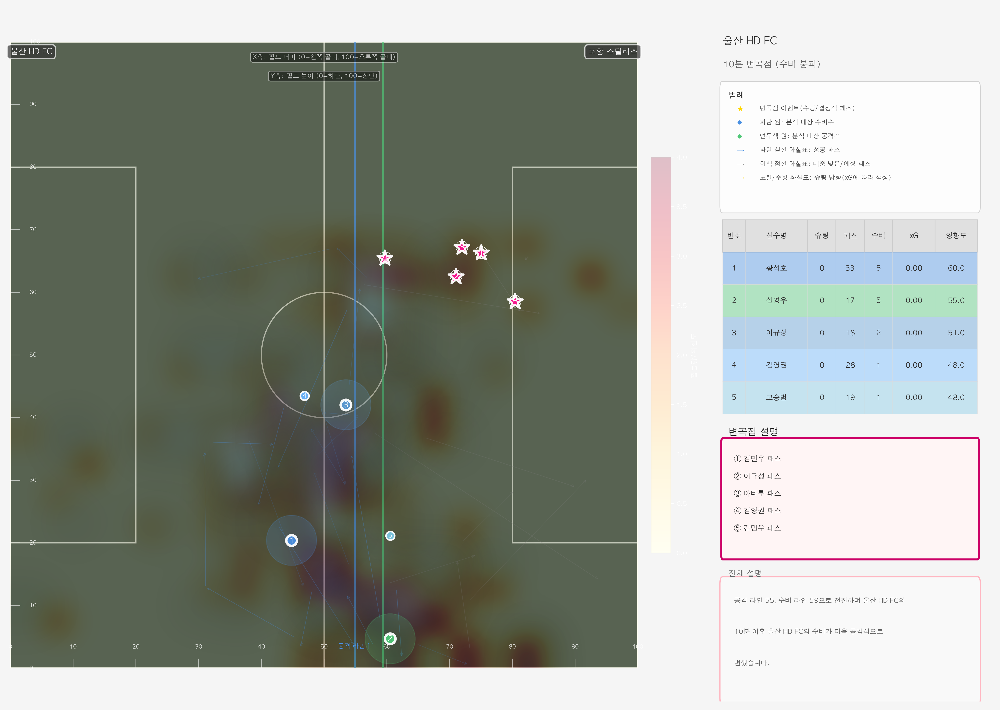

  선수 움직임 그래프 저장: movements_126283_10.png


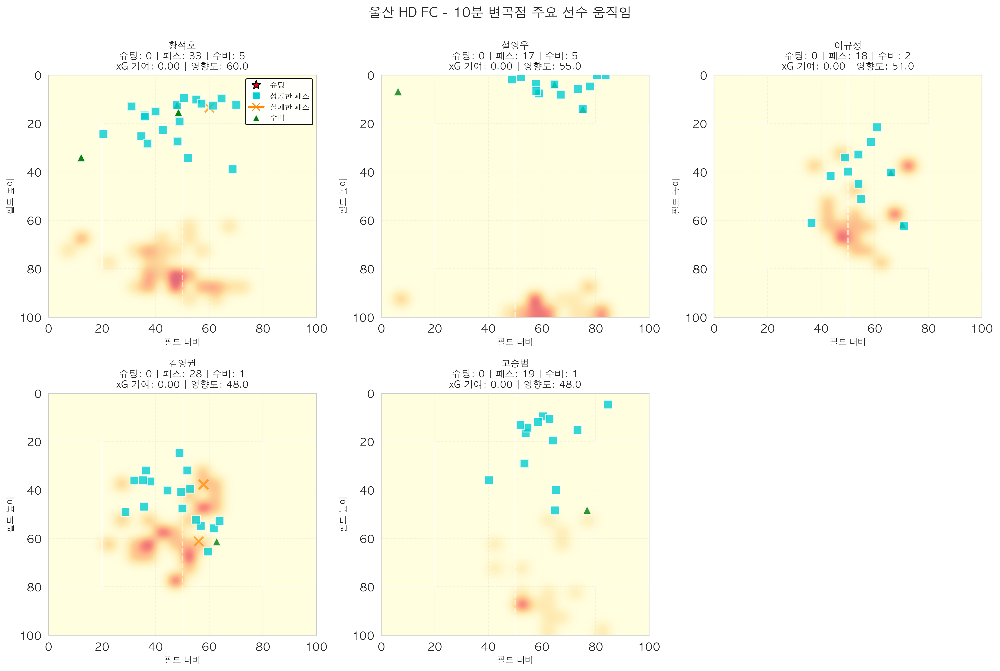


[20분] 변곡점 선수 분석...
  분석된 선수 수: 11
  주요 선수 (상위 5명):
    - 김영권: 영향도 52.0 (슈팅: 0, 패스: 15, xG: 0.00)
    - 황석호: 영향도 51.0 (슈팅: 0, 패스: 19, xG: 0.00)
    - 설영우: 영향도 48.0 (슈팅: 0, 패스: 15, xG: 0.00)
    - 고승범: 영향도 48.0 (슈팅: 0, 패스: 17, xG: 0.00)
    - 이규성: 영향도 48.0 (슈팅: 0, 패스: 17, xG: 0.00)
  히트맵 저장: heatmap_126283_20.png


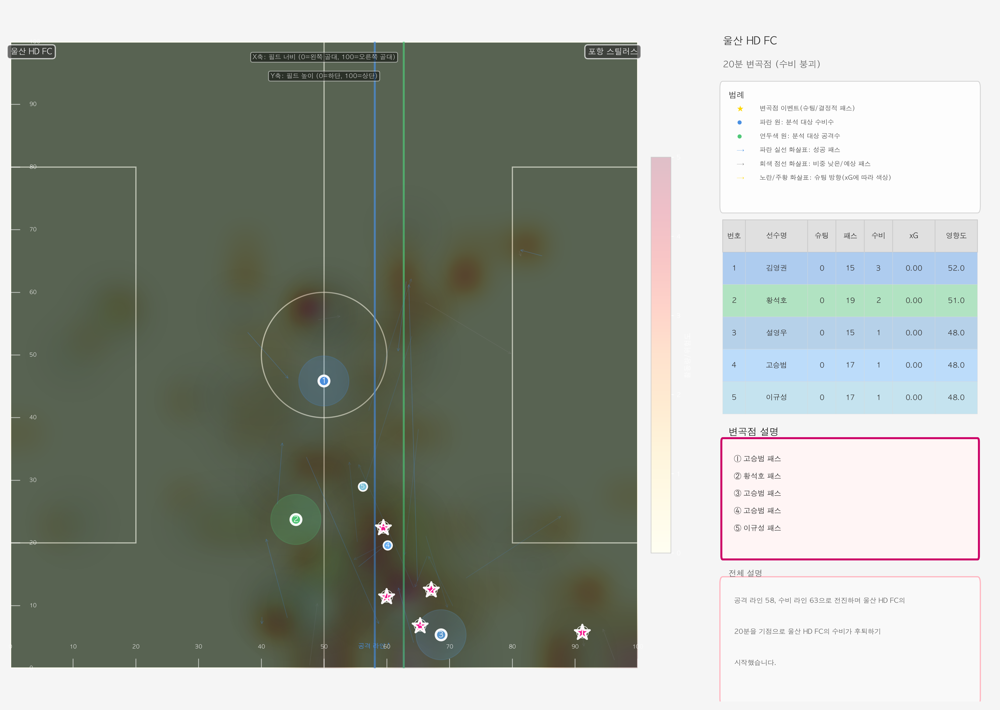

  선수 움직임 그래프 저장: movements_126283_20.png


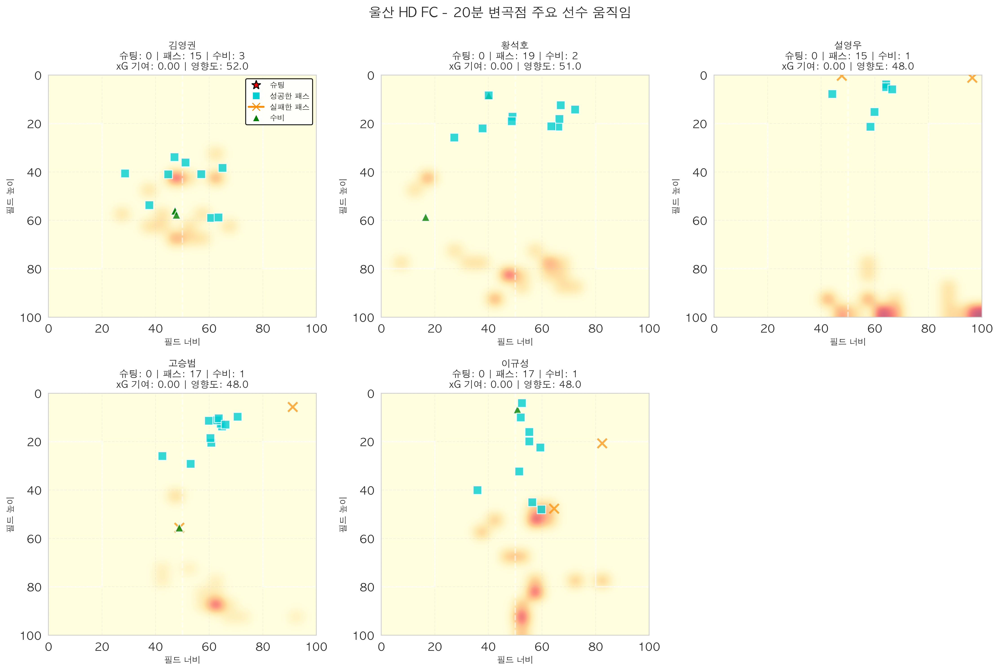


[25분] 변곡점 선수 분석...
  분석된 선수 수: 11
  주요 선수 (상위 5명):
    - 설영우: 영향도 63.9 (슈팅: 1, 패스: 16, xG: 0.40)
    - 고승범: 영향도 57.0 (슈팅: 0, 패스: 16, xG: 0.00)
    - 이규성: 영향도 57.0 (슈팅: 0, 패스: 18, xG: 0.00)
    - 김영권: 영향도 52.0 (슈팅: 0, 패스: 14, xG: 0.00)
    - 아타루: 영향도 51.0 (슈팅: 0, 패스: 11, xG: 0.00)
  히트맵 저장: heatmap_126283_25.png


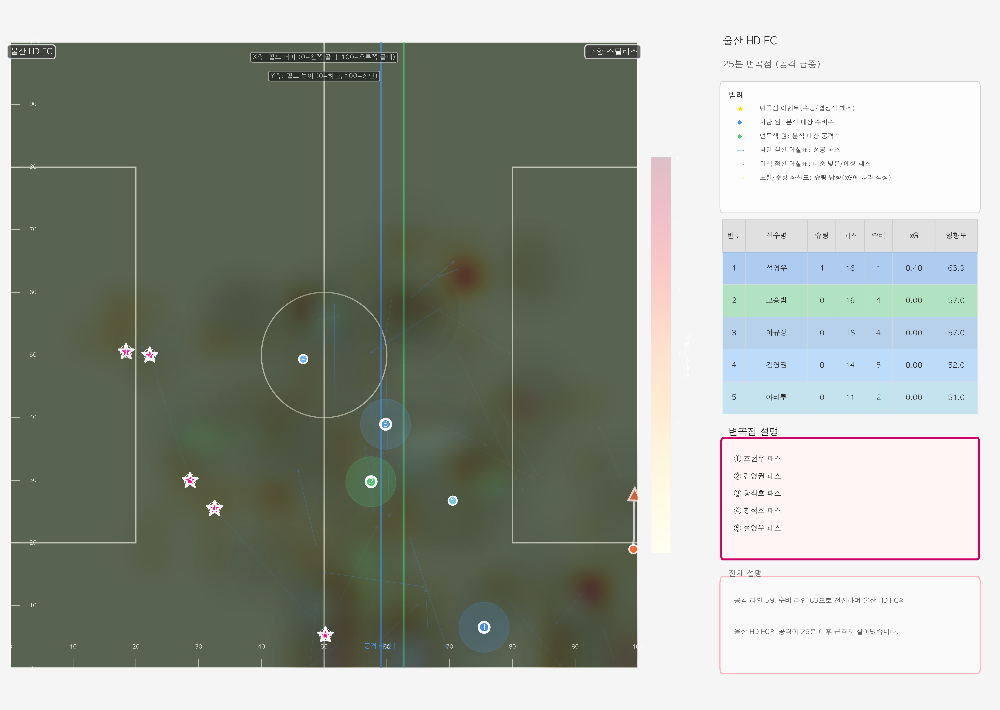

  선수 움직임 그래프 저장: movements_126283_25.png


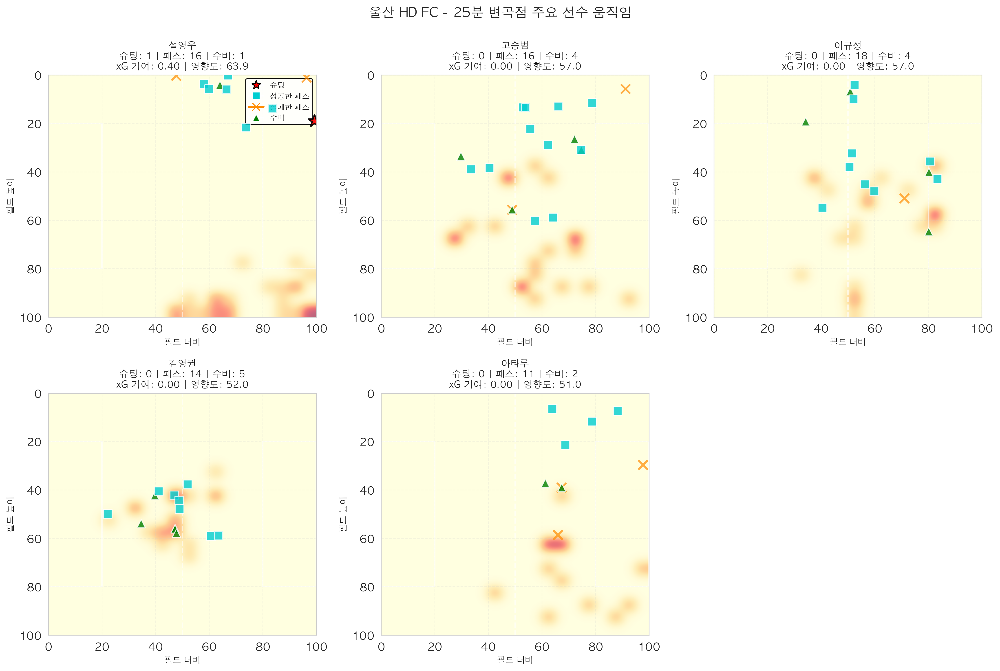


[30분] 변곡점 선수 분석...
  분석된 선수 수: 10
  주요 선수 (상위 5명):
    - 김륜성: 영향도 47.0 (슈팅: 0, 패스: 5, xG: 0.00)
    - 이동희: 영향도 31.0 (슈팅: 0, 패스: 11, xG: 0.00)
    - 한찬희: 영향도 31.0 (슈팅: 0, 패스: 4, xG: 0.00)
    - 완델손: 영향도 30.0 (슈팅: 0, 패스: 7, xG: 0.00)
    - 김준호: 영향도 27.0 (슈팅: 0, 패스: 6, xG: 0.00)
  히트맵 저장: heatmap_126283_30.png


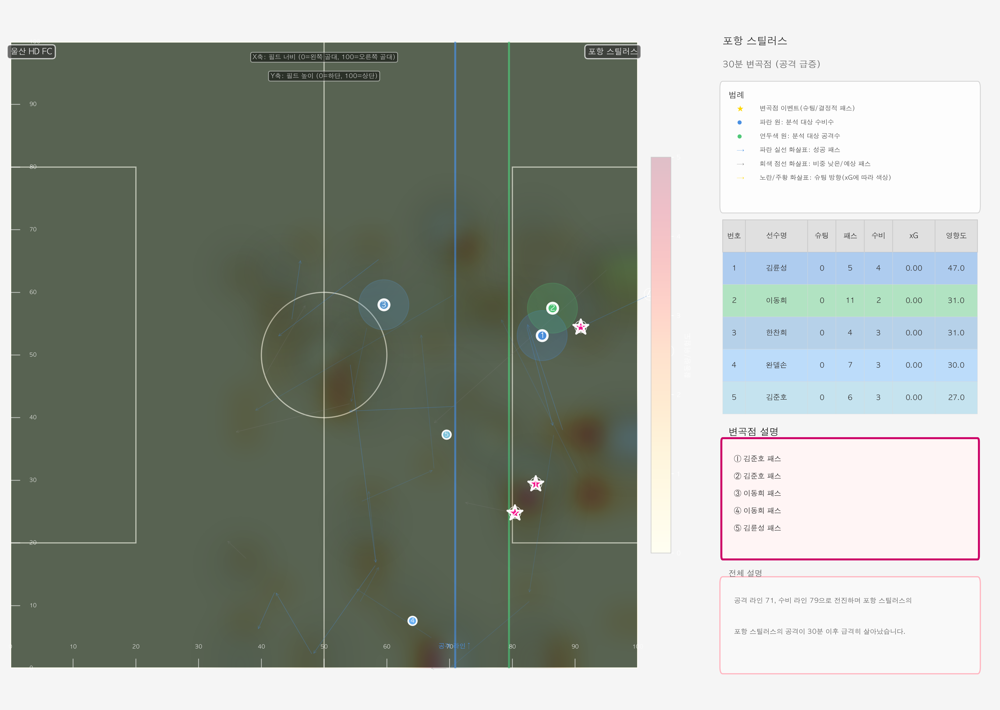

  선수 움직임 그래프 저장: movements_126283_30.png


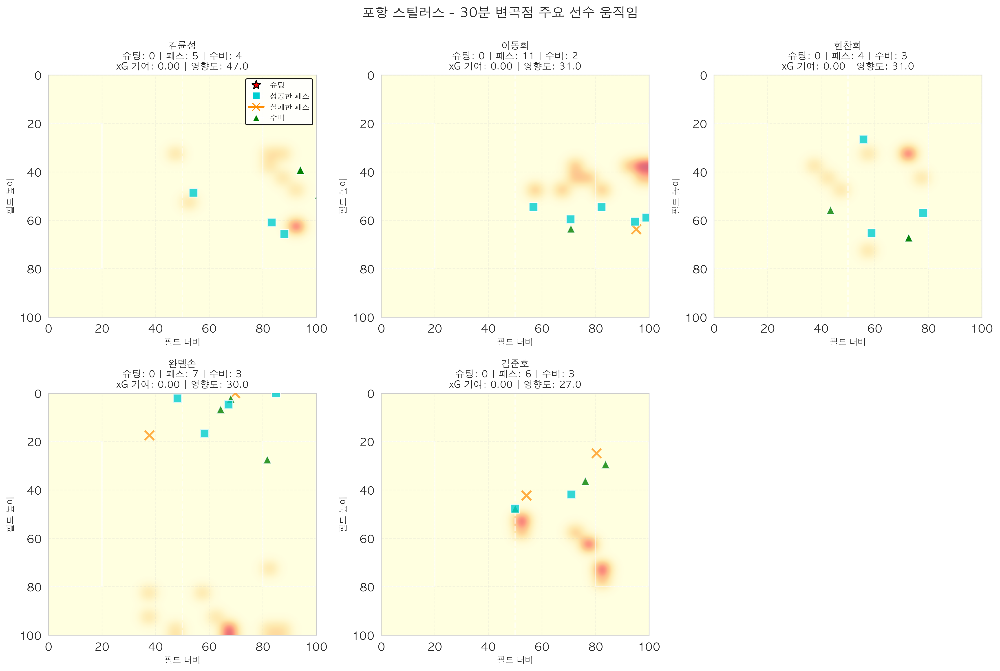


[35분] 변곡점 선수 분석...
  분석된 선수 수: 11
  주요 선수 (상위 5명):
    - 고승범: 영향도 48.0 (슈팅: 0, 패스: 19, xG: 0.00)
    - 김영권: 영향도 47.0 (슈팅: 0, 패스: 19, xG: 0.00)
    - 이규성: 영향도 43.0 (슈팅: 0, 패스: 10, xG: 0.00)
    - 황석호: 영향도 42.0 (슈팅: 0, 패스: 22, xG: 0.00)
    - 김민우: 영향도 35.0 (슈팅: 0, 패스: 5, xG: 0.00)
  히트맵 저장: heatmap_126283_35.png


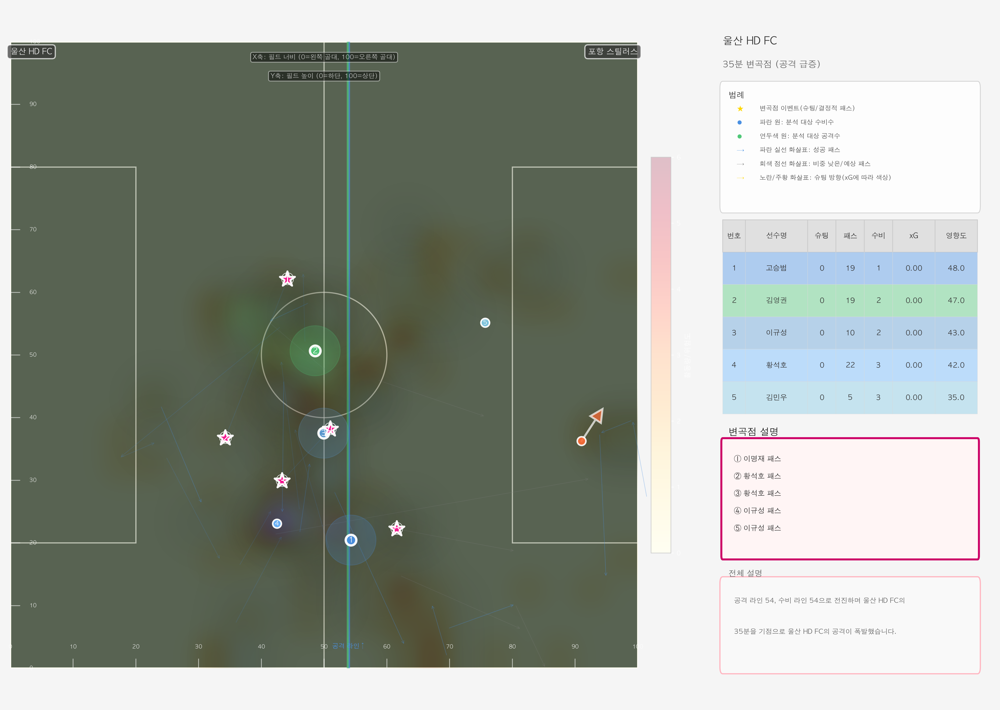

  선수 움직임 그래프 저장: movements_126283_35.png


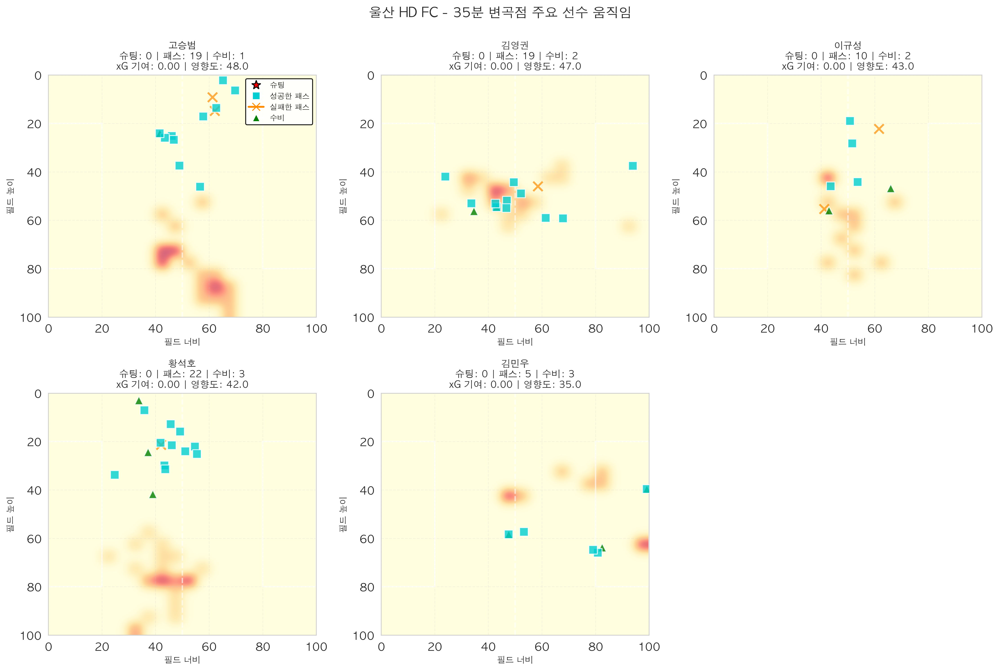


[40분] 변곡점 선수 분석...
  분석된 선수 수: 10
  주요 선수 (상위 5명):
    - 황석호: 영향도 56.0 (슈팅: 0, 패스: 22, xG: 0.00)
    - 김민우: 영향도 51.5 (슈팅: 1, 패스: 11, xG: 0.14)
    - 고승범: 영향도 51.0 (슈팅: 0, 패스: 23, xG: 0.00)
    - 이규성: 영향도 48.0 (슈팅: 0, 패스: 17, xG: 0.00)
    - 김영권: 영향도 48.0 (슈팅: 0, 패스: 26, xG: 0.00)
  히트맵 저장: heatmap_126283_40.png


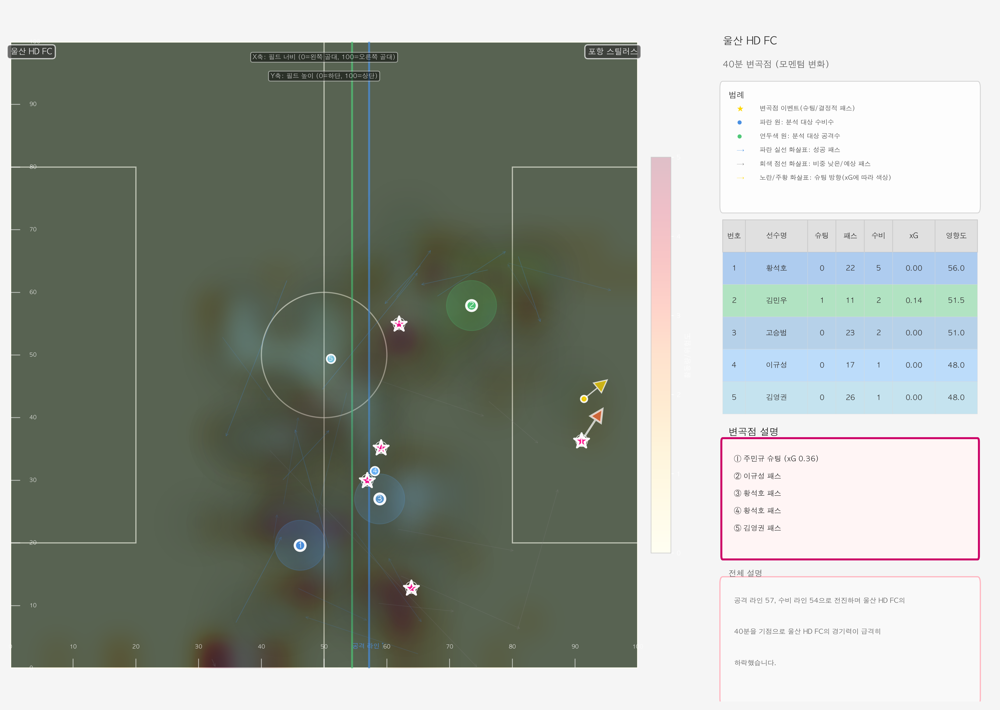

  선수 움직임 그래프 저장: movements_126283_40.png


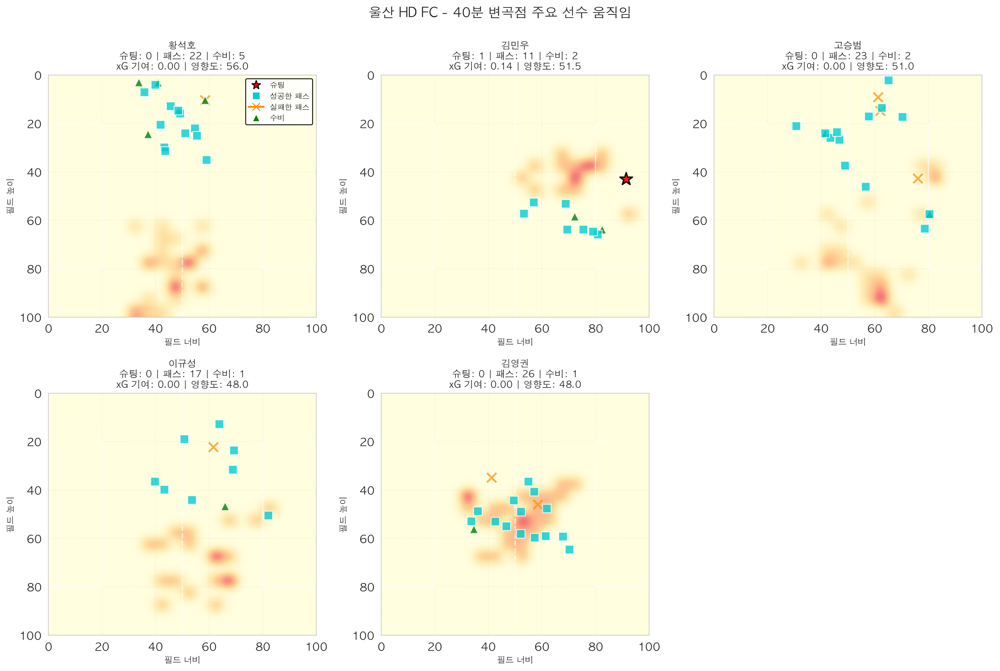


[50분] 변곡점 선수 분석...
  분석된 선수 수: 11
  주요 선수 (상위 5명):
    - 아타루: 영향도 91.0 (슈팅: 1, 패스: 8, xG: 1.00)
    - 설영우: 영향도 60.0 (슈팅: 0, 패스: 25, xG: 0.00)
    - 고승범: 영향도 57.0 (슈팅: 0, 패스: 15, xG: 0.00)
    - 황석호: 영향도 50.0 (슈팅: 0, 패스: 14, xG: 0.00)
    - 이규성: 영향도 45.0 (슈팅: 0, 패스: 14, xG: 0.00)
  히트맵 저장: heatmap_126283_50.png


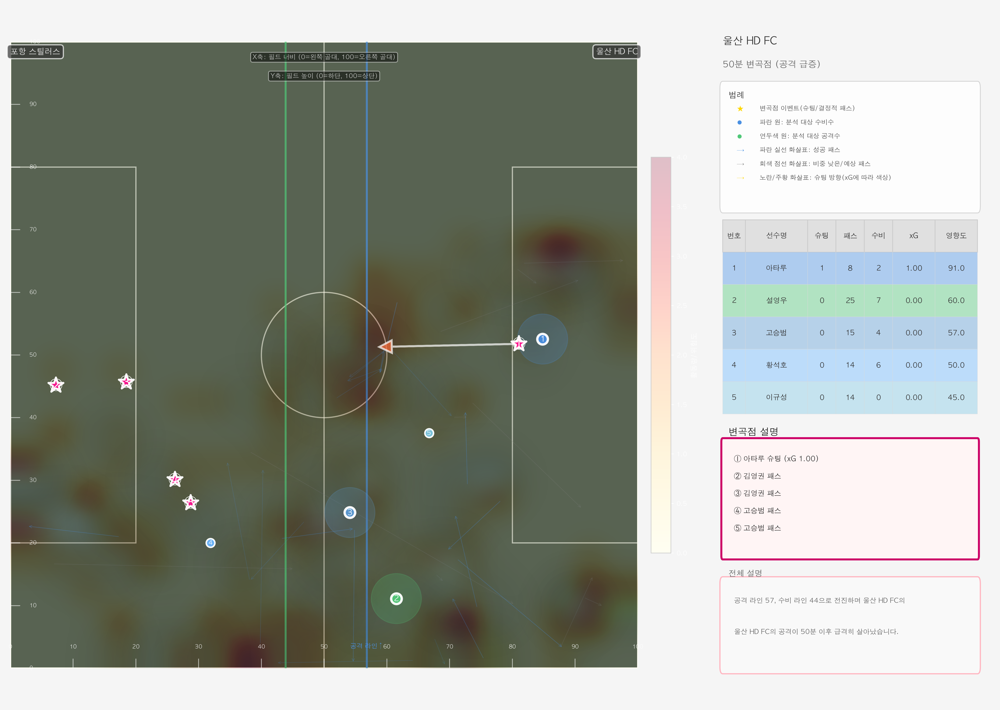

  선수 움직임 그래프 저장: movements_126283_50.png


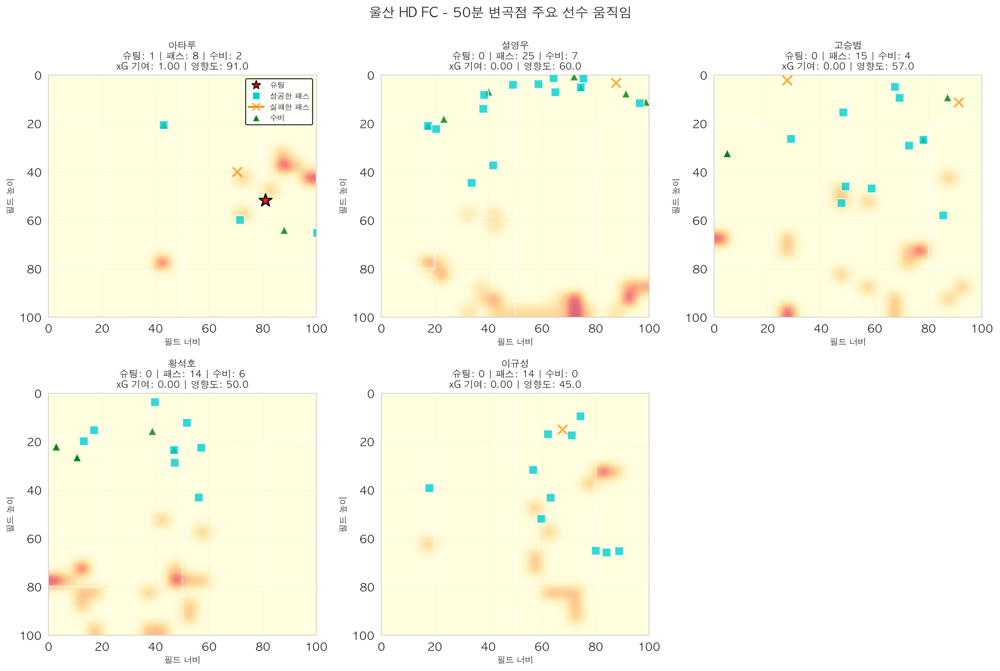


[55분] 변곡점 선수 분석...
  분석된 선수 수: 11
  주요 선수 (상위 5명):
    - 아타루: 영향도 84.0 (슈팅: 1, 패스: 7, xG: 1.00)
    - 황석호: 영향도 54.0 (슈팅: 0, 패스: 17, xG: 0.00)
    - 김민우: 영향도 54.0 (슈팅: 0, 패스: 7, xG: 0.00)
    - 고승범: 영향도 52.0 (슈팅: 0, 패스: 12, xG: 0.00)
    - 설영우: 영향도 45.0 (슈팅: 0, 패스: 13, xG: 0.00)
  히트맵 저장: heatmap_126283_55.png


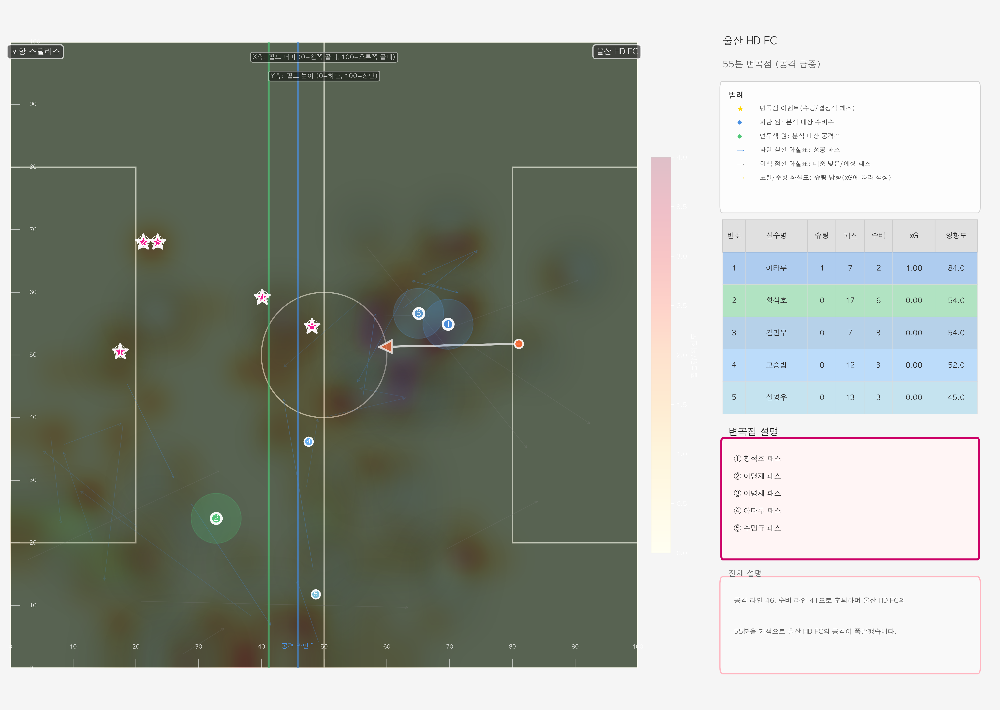

  선수 움직임 그래프 저장: movements_126283_55.png


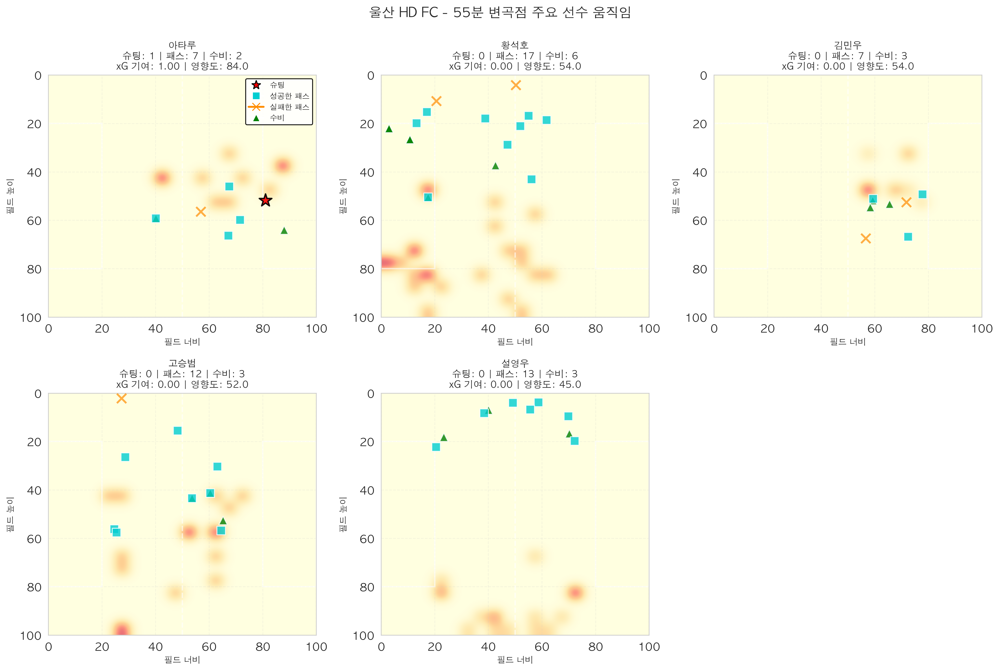


[60분] 변곡점 선수 분석...
  분석된 선수 수: 11
  주요 선수 (상위 5명):
    - 김민우: 영향도 57.0 (슈팅: 0, 패스: 7, xG: 0.00)
    - 이규성: 영향도 56.0 (슈팅: 0, 패스: 10, xG: 0.00)
    - 황석호: 영향도 56.0 (슈팅: 0, 패스: 16, xG: 0.00)
    - 고승범: 영향도 47.0 (슈팅: 0, 패스: 12, xG: 0.00)
    - 아타루: 영향도 43.0 (슈팅: 0, 패스: 7, xG: 0.00)
  히트맵 저장: heatmap_126283_60.png


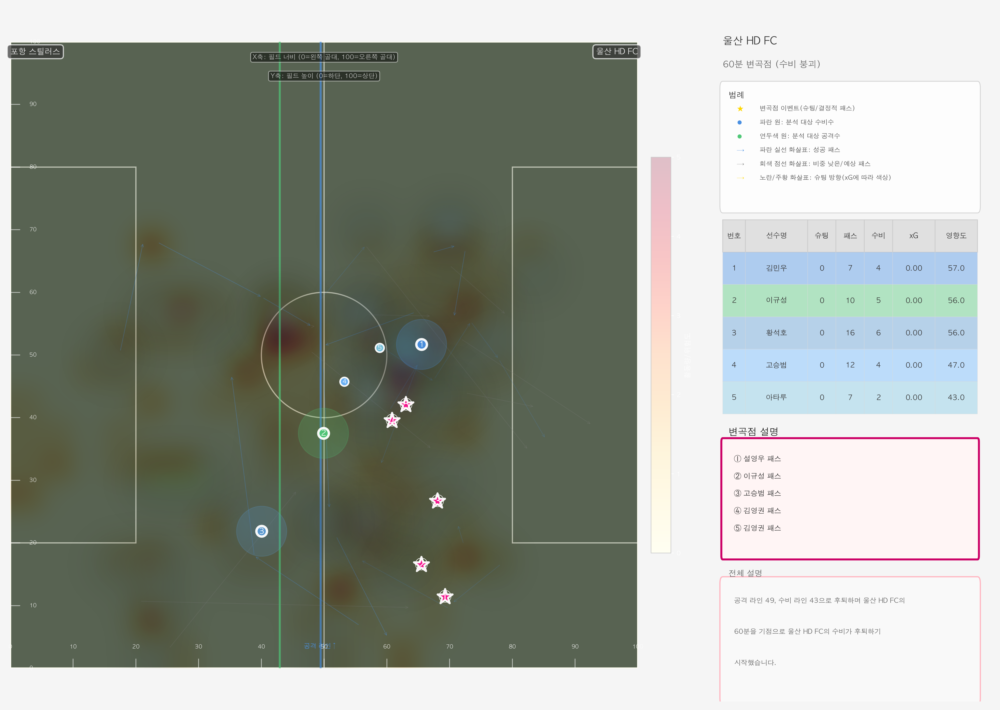

  선수 움직임 그래프 저장: movements_126283_60.png


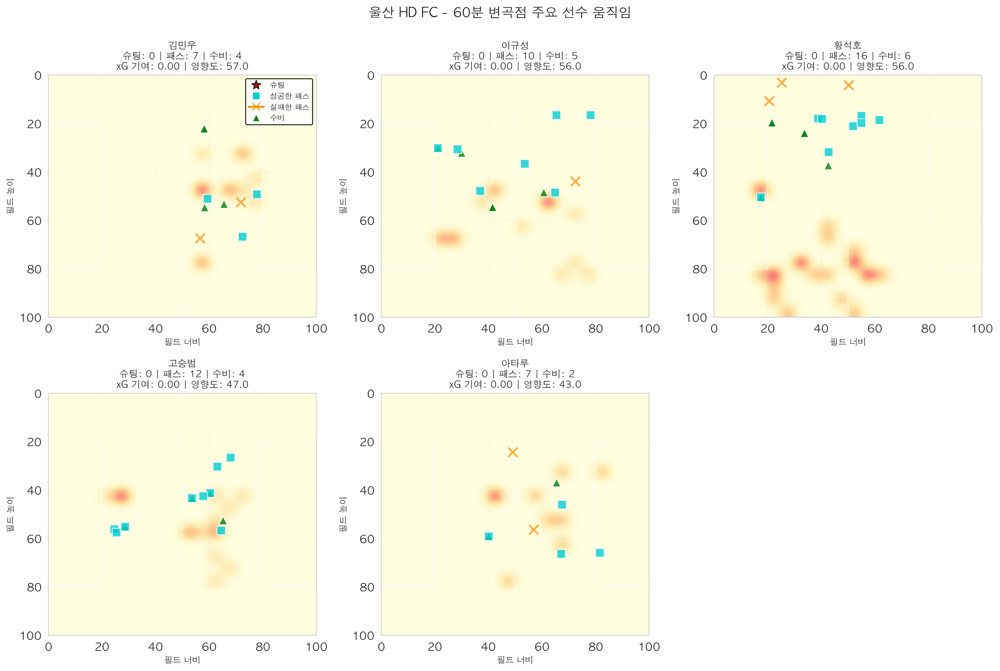


[65분] 변곡점 선수 분석...
  분석된 선수 수: 11
  주요 선수 (상위 5명):
    - 오베르단: 영향도 51.0 (슈팅: 0, 패스: 19, xG: 0.00)
    - 이동희: 영향도 45.0 (슈팅: 0, 패스: 11, xG: 0.00)
    - 아스프로: 영향도 44.0 (슈팅: 0, 패스: 11, xG: 0.00)
    - 한찬희: 영향도 40.0 (슈팅: 0, 패스: 10, xG: 0.00)
    - 완델손: 영향도 31.0 (슈팅: 0, 패스: 8, xG: 0.00)
  히트맵 저장: heatmap_126283_65.png


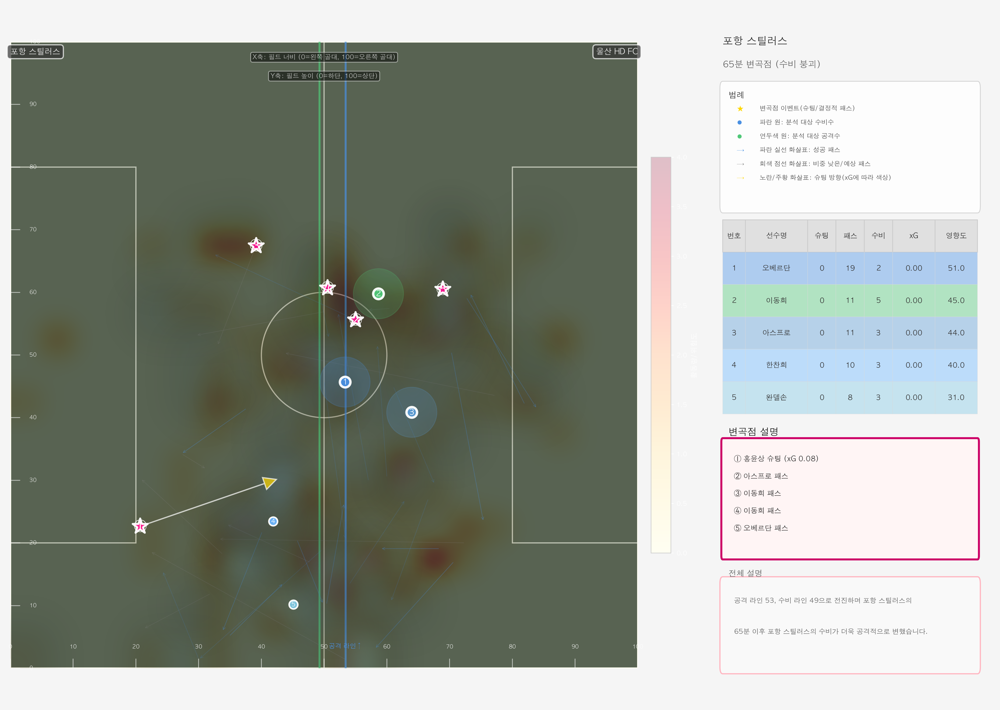

  선수 움직임 그래프 저장: movements_126283_65.png


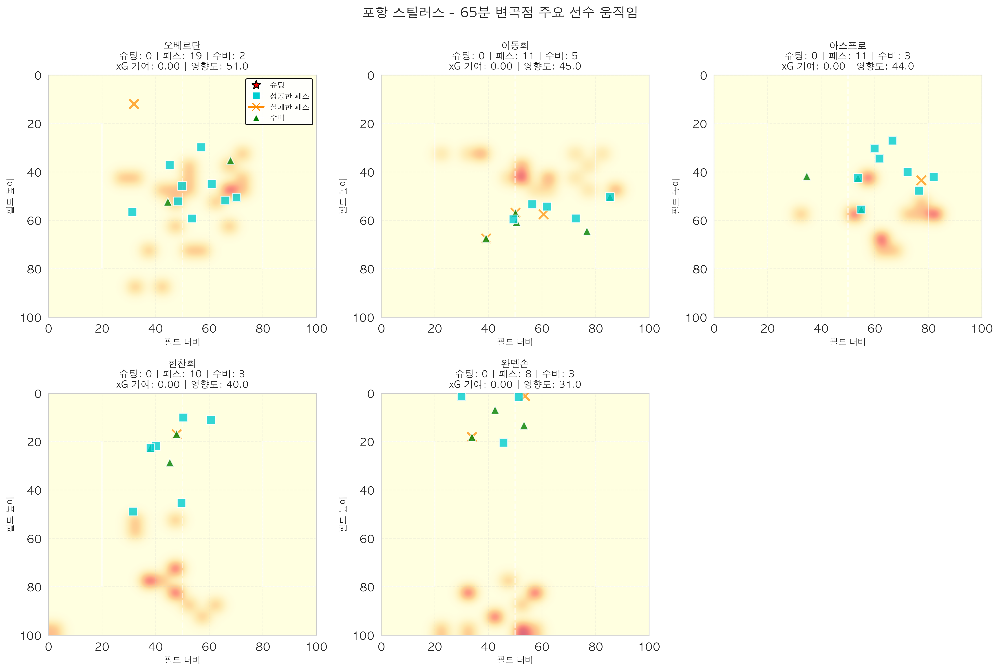


[70분] 변곡점 선수 분석...
  분석된 선수 수: 12
  주요 선수 (상위 5명):
    - 아스프로: 영향도 55.0 (슈팅: 0, 패스: 13, xG: 0.00)
    - 오베르단: 영향도 48.0 (슈팅: 0, 패스: 20, xG: 0.00)
    - 한찬희: 영향도 44.8 (슈팅: 1, 패스: 15, xG: 0.02)
    - 김륜성: 영향도 41.0 (슈팅: 0, 패스: 10, xG: 0.00)
    - 박찬용: 영향도 36.0 (슈팅: 0, 패스: 13, xG: 0.00)
  히트맵 저장: heatmap_126283_70.png


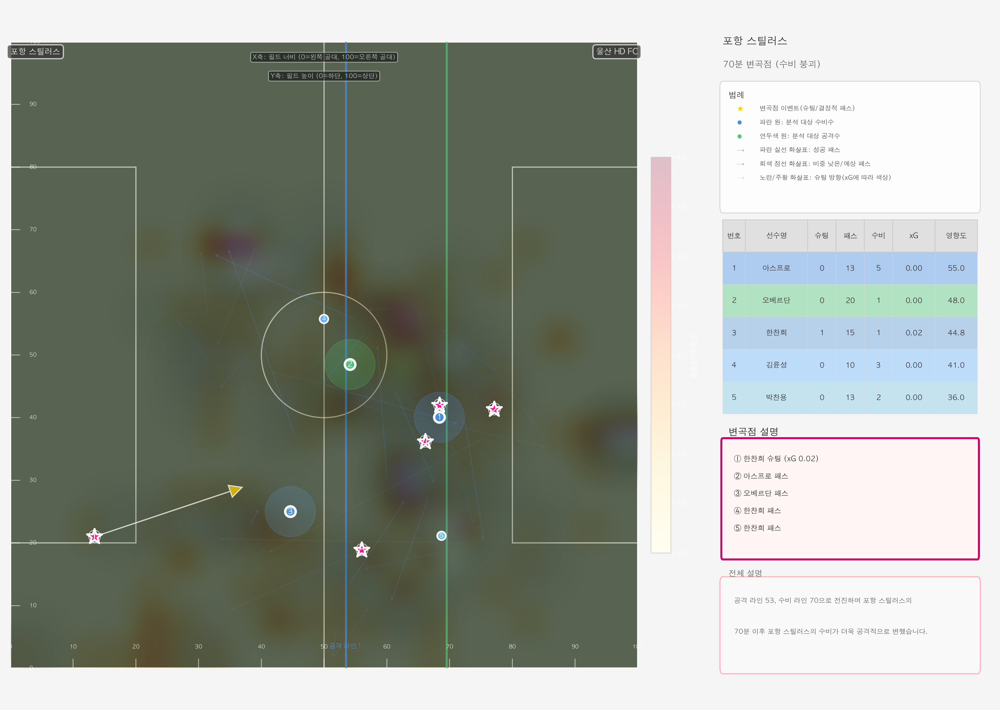

  선수 움직임 그래프 저장: movements_126283_70.png


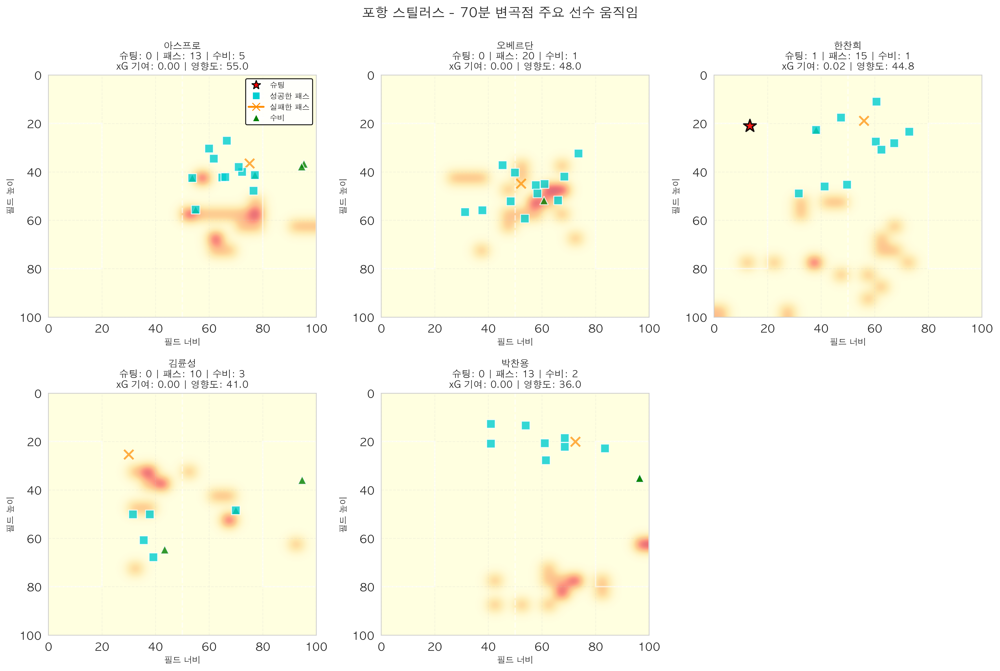


[80분] 변곡점 선수 분석...
  분석된 선수 수: 11
  주요 선수 (상위 5명):
    - 이동경: 영향도 60.0 (슈팅: 0, 패스: 7, xG: 0.00)
    - 엄원상: 영향도 60.0 (슈팅: 1, 패스: 9, xG: 0.15)
    - 루빅손: 영향도 49.5 (슈팅: 1, 패스: 4, xG: 0.36)
    - 이규성: 영향도 38.0 (슈팅: 0, 패스: 6, xG: 0.00)
    - 아타루: 영향도 38.0 (슈팅: 0, 패스: 4, xG: 0.00)
  히트맵 저장: heatmap_126283_80.png


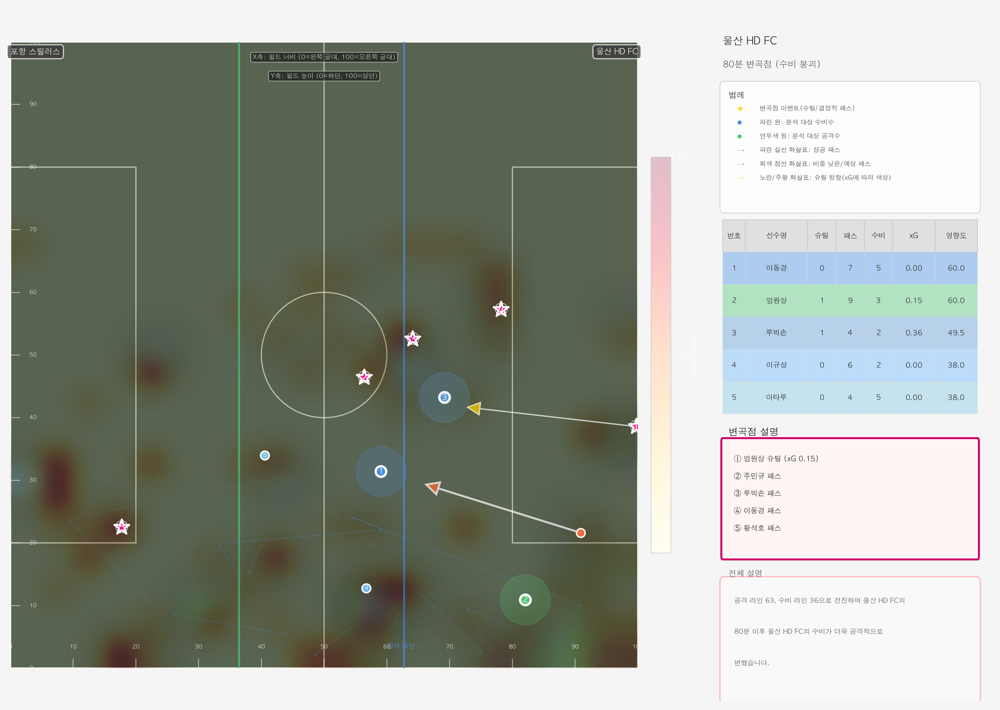

In [ ]:
# 변곡점별 선수 분석 및 히트맵 생성
if turning_points:
    print("변곡점별 선수 분석 중...")
    for tp in turning_points:
        print(f"\n[{tp.minute}분] 변곡점 선수 분석...")
        
        # 선수 활동 추출
        player_activities = extract_player_activities(match_data, tp)
        
        if player_activities:
            # 주요 선수 식별
            key_players = get_key_players(player_activities, top_n=5)
            
            print(f"  분석된 선수 수: {len(player_activities)}")
            print(f"  주요 선수 (상위 5명):")
            for player_name, activity, impact_score in key_players:
                print(f"    - {player_name}: 영향도 {impact_score:.1f} "
                      f"(슈팅: {activity.shots}, 패스: {activity.passes}, "
                      f"xG: {activity.xg_contribution:.2f})")
            
            # 히트맵 생성
            heatmap_path = f"heatmap_{game_id}_{tp.minute}.png"
            plot_player_heatmap(match_data, tp, player_activities, heatmap_path)
            print(f"  히트맵 저장: {heatmap_path}")
            
            # 히트맵 이미지를 노트북 셀에 인라인으로 표시
            if os.path.exists(heatmap_path):
                display(Image(heatmap_path))
            
            # 선수 움직임 시각화
            movements_path = f"movements_{game_id}_{tp.minute}.png"
            plot_player_movements(match_data, tp, player_activities, top_n=5, save_path=movements_path)
            print(f"  선수 움직임 그래프 저장: {movements_path}")
            
            # 움직임 그래프 이미지를 노트북 셀에 인라인으로 표시
            if os.path.exists(movements_path):
                display(Image(movements_path))
        else:
            print(f"  해당 시점의 선수 데이터를 찾을 수 없습니다.")